# Checking if we are in the right host

In [2]:
!hostname

pcn-5-09


# Loading required modules

In [3]:
import numpy as np 
import pickle
from matplotlib import pyplot as plt
from galpy.util import bovy_coords as coords

/mnt/home/bbhattarai/.local/lib/python3.7/site-packages/galpy/util/bovy_coords.py:6: FutureWarning: galpy.util.bovy_coords is being deprecated in favor of galpy.util.coords; all functions in there are the same; please switch to the new import, because the old import will be removed in v1.9
  warnings.warn('galpy.util.bovy_coords is being deprecated in favor of galpy.util.coords; all functions in there are the same; please switch to the new import, because the old import will be removed in v1.9',FutureWarning)



# Loading Data

In [4]:
datapath="/mnt/home/bbhattarai/B3/"


The bar angle is -1.958325946454705
counts:  [214600. 218324. 219636. 220768. 223744. 226912. 228856. 232728. 233540.
 236236. 240272. 243076. 245988. 246868. 252832. 253396. 258396. 260700.
 265776. 266772. 274616. 275528. 283128. 285992. 291660. 296020. 303976.
 306740. 313404. 317940. 322500. 330968. 336872. 343320. 350156. 356604.
 366972. 371752. 380760. 390408. 396836. 403120. 410816. 418088. 425764.
 433908. 436788. 441384. 446280. 452020. 454000. 456676. 455396. 462060.
 459244. 460092. 460292. 457716. 454072. 452736. 446196. 445008. 435856.
 432660. 424060. 417684. 411160. 402996. 396360. 387784. 378504. 370312.
 361072. 353592. 345848. 337580. 333324. 327392. 317324. 312080. 308504.
 299912. 295224. 289128. 284972. 278852. 274548. 270516. 263392. 260064.
 255064. 251580. 246672. 242668. 238020. 236704. 234752. 229804. 226904.
 226844. 221624. 217652. 217192. 211648. 210712. 209680. 207396. 205020.
 202856. 201588. 198044. 197324. 194124. 191164. 191388. 191084. 186648.
 18653

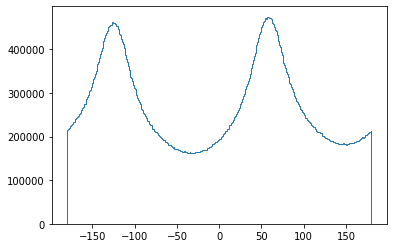

In [46]:
snapshot=301
pfile = open(datapath+'step'+str(snapshot)+'.p', 'rb')
idd,x,y,z,vx,vy,vz,mass=pickle.load(pfile)
#Converting to cylindrical
vr,vphi,vzz=coords.rect_to_cyl_vec(vx,vy,vz,x,y,z)
r,phi,zz=coords.rect_to_cyl(x,y,z)
#converting phi to degrees
phi=np.rad2deg(phi)
discindx=(mass<1e-7)
barsample=(r<3)*discindx
counts, bins, patches=plt.hist(phi[barsample],bins=360,histtype='step')
yfa=np.fft.fft(counts)
mode2=yfa[2]/yfa[0]
barangle=np.angle(yfa[2])
print("The bar angle is",barangle)
print("counts: ",counts)
print("bins: ",bins)


In [7]:
barangle_degrees=np.rad2deg(barangle)
print("Barangle in degrees",barangle_degrees)

Barangle in degrees -112.20381164281703


# Rotating wrt to bar_angle

In [25]:
rotation_angle=barangle_degrees+25
rot_angle_radians=np.deg2rad(rotation_angle)
x_rot=x*np.cos(rot_angle_radians)-y*np.sin(rot_angle_radians) #take care of radians and degress
y_rot=x*np.sin(rot_angle_radians)+y*np.cos(rot_angle_radians)
R_rot=(x_rot**2+y_rot**2)**(1/2)
R=(x**2+y**2)**(1/2)
phi=np.arctan(y_rot/x_rot) #this is different from the original phi

In [28]:
#converting phi to degrees
phi=np.rad2deg(phi)

In [39]:
keep_phi=(phi<5)*(phi>-5)


In [3]:
!pwd

/mnt/home/bbhattarai


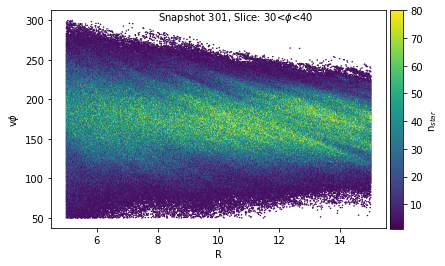

In [40]:
plotpath="./resonance_sweeping/plots/"+str(snapshot)+"/"
fig2=plt.figure()
ax=fig2.add_subplot(111)
ax.text(8,300,r"Snapshot %s, Slice: 30<$\phi$<40"%(str(snapshot)))
cb1=ax.hexbin(r[keep_phi],vphi[keep_phi],extent=((5,15,50,300)),gridsize=500,mincnt=1,vmin=1,vmax=80)
ax.set_xlabel("R")
ax.set_ylabel(r"v$\phi$")
cbar_ax = fig2.add_axes([0.91, 0.12, 0.03, 0.76]) # position of the colorbar (left, bottom, width, height)
fig2.colorbar(cb1, cax=cbar_ax)
cbar_ax.set_ylabel(r'n$_{star}$')
cbar_ax.yaxis.label.set_size(10)
plotname=str(snapshot)+"_v_phi_vs_r_hexbin.jpg"
#fig2.savefig(plotpath+plotname,bbox_inches="tight")
plt.show()

# Creating plots for multiple regions in x

In [24]:
plotpath="./resonance_sweeping/plots/"+str(snapshot)+"/"
for i in range(0,25):
    keep=(x<i+1)*(x>i)*(y>-1)*(y<1)
    fig3=plt.figure()
    ax=fig3.add_subplot(111)
    ax.hexbin(vr[keep],vphi[keep],extent=((-200,200,50,300)),gridsize=300,bins="log",mincnt=1)
    ax.set_xlabel("vR")
    ax.set_ylabel(r"v$\phi$")
    ax.set_title(r"Snapshot %s, Region: %d<x<%d, -1<y<1"%(str(snapshot),i,i+1))
    #ax.text(-100,300,r"Snapshot %s, Region: %d<x<%d, -1<y<1"%(str(snapshot),i,i+1))
    plotname="v_phi_vs_v_r_selected_region_"+str(i)+"_to_"+str(i+1)+".jpg"
    fig3.savefig(plotpath+plotname,bbox_inches="tight")
    print("Saved to file...: ",plotname)
    plt.close(fig3)

Saved to file...:  v_phi_vs_v_r_selected_region_0_to_1.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_1_to_2.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_2_to_3.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_3_to_4.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_4_to_5.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_5_to_6.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_6_to_7.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_7_to_8.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_8_to_9.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_9_to_10.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_10_to_11.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_11_to_12.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_12_to_13.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_13_to_14.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_14_to_15.jpg
Saved to file...:  v_phi_vs_v_r_selected_region_15_to_16.jpg
Saved to file...:  v_phi_vs_v_r_selected_re

In [20]:
!hostname

pcn-9-60


# Creating plot for entire regions in phi

In [7]:
plotpath="./resonance_sweeping/plots/"+str(snapshot)+"/"
for i in range(-180,180,10):
    keep_phi=(phi<i+5)*(phi>i)
    fig2=plt.figure()
    ax=fig2.add_subplot(111)
    ax.set_title(r"Snapshot %s, Slice: %d<$\phi$<%d"%(str(snapshot),i,i+10))
    #ax.text(8,300,r"Snapshot %s, Slice: %d<$\phi$<%d"%(str(snapshot),i,i+5))
    cb1=ax.hexbin(r[keep_phi],vphi[keep_phi],extent=((5,15,50,300)),gridsize=500,mincnt=1,vmin=1,vmax=40)
    ax.set_xlabel("r")
    ax.set_ylabel(r"v$\phi$")
    cbar_ax = fig2.add_axes([0.91, 0.12, 0.03, 0.76]) # position of the colorbar (left, bottom, width, height)
    fig2.colorbar(cb1, cax=cbar_ax)
    cbar_ax.set_ylabel(r'n$_{star}$')
    cbar_ax.yaxis.label.set_size(10)
    plotname=str(snapshot)+"_v_phi_vs_r_hexbin_"+str(i)+"_to_"+str(i+10)+".jpg"
    fig2.savefig(plotpath+plotname,bbox_inches="tight")
    print("Saved to filename: ",plotname)
    plt.close(fig2)

Saved to filename:  301_v_phi_vs_r_hexbin_-180_to_-170.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-170_to_-160.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-160_to_-150.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-150_to_-140.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-140_to_-130.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-130_to_-120.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-120_to_-110.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-110_to_-100.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-100_to_-90.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-90_to_-80.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-80_to_-70.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-70_to_-60.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-60_to_-50.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-50_to_-40.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-40_to_-30.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-30_to_-20.jpg
Saved to filename:  301_v_phi_vs_r_hexbin_-20_to_-10.jpg
Saved to filen